### iCESM VOLC Average Tutorial

##### For this tutorial we will be using CMIP6 data to construct a regional average plot of the air surface temperature over time in New York City

In [2]:
pwd

'/Users/calipfleger/Desktop/volcano'

#### __Step 1. Install and Import Packages__

##### Let's start in the __terminal__ and install "__cfTime__" which allows us to read our NetCDF files more efficiently

In [1]:
from datetime import datetime
now = datetime.now()
current_time = now.strftime("%H:%M:%S")
current_day =  now.strftime("%D")
print("Today's Date is:", current_day)
print("Current Time is :", current_time)

Today's Date is: 02/13/25
Current Time is : 19:49:23


##### Next install these packages in your __terminal__ if not already installed

Great! The needed packages for our time series graph are installed in the terminal, lets quickly import them into our jupiter python notebook¶

In [15]:
import netCDF4
from netCDF4 import Dataset as nc
from netCDF4 import num2date

In [16]:
import xarray as xr
import numpy as np
#import cftime
import pandas as pd
from numpy import *
from scipy import stats
import datetime
from tqdm import tqdm
import matplotlib as mpl
import matplotlib.pyplot as plt #python plotting package
from matplotlib import cm
import matplotlib.colors as mcolors
#from colorspacious import cspace_converter
from collections import OrderedDict
cmaps = OrderedDict()
import cartopy.crs as ccrs
import cartopy.feature as cfeature
#import nctoolkit
import matplotlib.ticker as mticker
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cpf
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from shapely import geometry
from collections  import namedtuple
from shapely.geometry.polygon import LinearRing
from shapely.geometry.polygon import Polygon

##### What are we installing and importing exactly?
- ##### `pandas` is a data manipulation and analysis library that will be used to provide data structures like DataFrame
- ##### `matplotlib` is a plotting library that will be used to plot maps and geospatial data
- ##### `xarray` can read and write NetCDF files
- ##### `numpy` is used for working with arrays and will help us create our custom x-axis

#### __Step 2. Set the path to your NetCDF file__
- ##### The download of a NetCDF file off the ESGF website was shown previously in tutorial previously shown
- ##### We’ll use the `xr.open_dataset()` function from xarray to open the NetCDF file.
- ##### This function reads the file and loads it into an xarray.Dataset object and allows for easy manipulation and analysis of the data.

## Create vartiables to plot pwc timeseries

In [17]:
# CESM converting month 01 to January 
from itertools import product
from cftime import DatetimeNoLeap
year = np.linspace(0,1872, 1872) 
dates = [DatetimeNoLeap(year, month, 1) for year, month in product(range(1850, 2006), range(1, 13))]
da = xr.DataArray(np.arange(1872), coords=[dates], dims=['time'], name='time')
i_cntlyear = np.linspace(0,2400, 2400) 
i_cntldates = [DatetimeNoLeap(i_cntlyear, month, 1) for i_cntlyear, month in product(range(650, 850), range(1, 13))]
i_cntlda =xr.DataArray(np.arange(2400), coords=[i_cntldates], dims=['time'], name='time')

# Read in Precipitation Files: Total Precipitation (PRECT)

In [32]:
var_full = xr.open_dataset('this is the path to your/.nc').sel(lat=slice(-35,35),lon=slice(75,290)).PRECC.squeeze()
var_volc = xr.open_dataset('this is the path to your/.nc').sel(lat=slice(-35,35),lon=slice(75,290)).PRECC.squeeze()
var_cntl = xr.open_dataset('this is the path to your/.nc').sel(lat=slice(-35,35),lon=slice(75,290)).PRECC.squeeze()


'/glade/u/home/calipfleger/stats/PWC_Paper/pwc_clean'

#### __Step 3. Print our NetCDF file__
- ##### Use the `print()` function
- ##### file is labeled "data"

In [1]:
#print(var_full)

# Create vartiables to plot pwc timeseries

In [35]:
## Get the lengths of lat, lon and time
nlon=len(var_full.lon)
nlat=len(var_full.lat)
ntime=len(var_full.time)
time = var_full.time
lon = var_full.lon
lat = var_full.lat
tlen = len(var_full[0])
dt = 1/12  # In years
t_post = np.arange(0,1872)*dt +1850
t_seas= np.arange(0, 157) +1850 
da = xr.DataArray(np.arange(1872), coords=[dates], dims=['time'], name='time')
year = np.linspace(0,1872, 1872) 

In [36]:
## Create time variables to calculate annual mean SLP
mo=12
yr=ntime//mo
post_yr = ntime_post//mo
post_year=linspace(1850,2005,156)

## Plotting Parameters 

In [41]:
# Set for each variable
variable = 'Total Precipitation Mean State'
climt = ' Mean State'
unit = ' mm/day'
plt_ylabel = "Total Precipitation (mm/day)"
vari ='/PRECT'

In [52]:
months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
var_name = ['Full Forcing', 'Volcanic']

colors = ['green', 'black']
colors_ribbon = ['lightgreen' ,'lightgrey']
var_namets = ['Full Forcing', 'Volcanic']
var_names = ['DJF', 'MAM', 'JJA', 'SON']#, 'ANTHRO']'LULC'

In [43]:
## Make geom for E and W PWC index boxes
Elats = [-5, -5, 5, 5]
Elons = [90, 150, 150,90]
Ering = LinearRing(list(zip(Elons, Elats)))
Wlats = [-5, -5, 5, 5]
Wlons = [-150,-90,-90,-150]
Wring = LinearRing(list(zip(Wlons, Wlats)))

# Calculate Anomalies and Mean State Climatology

In [45]:
## Climatology Definition 
def clim(c): 
    clim_var = c.groupby('time.month').mean('time')
    anom_var = c.groupby('time.month') - clim_var
    anom_var= anom_var.compute()
    return anom_var

In [47]:
#%%time
## climatology realtive to the anomaly 
#anom_full = clim(var_full)
#anom_volc = clim(var_volc)
#anom_cntl =clim(var_cntl)

In [46]:
def ms(c):
    v = c.mean(dim = 'time')
    sd = c.std(dim = 'time')
    z = (c-v)/sd
    #zz = z.mean(dim = 'ensemble')
    return z

In [48]:
%%time
anom_full = ms(var_full)
anom_volc = ms(var_volc)
anom_cntl =ms(var_cntl)

CPU times: user 1.05 s, sys: 420 ms, total: 1.47 s
Wall time: 1.63 s


In [61]:
def msplot(zz):
    fig = plt.figure(figsize=(20,10))
    fig.dpi = 600
    clevs = np.arange(-1.05, 1.05, 0.05)
    dx = []
    for i in np.arange(len(zz)):
        ep = zz[i].mean(dim = 'ensemble')
        ax = plt.subplot(1, 2, i+1, projection=ccrs.PlateCarree(central_longitude=-179.5))
        ax.set_extent([lon.min(), lon.max(), lat.min(), lat.max()], crs=ccrs.PlateCarree(central_longitude=-179.5))
        cf = ax.pcolormesh(lon, lat, ep[i], transform=ccrs.PlateCarree(),cmap='seismic', shading='gouraud',
                           vmin = -5, vmax =5)

        ax.coastlines(linewidths=1.0)
        ax.set_aspect('equal')
        ax.set_extent([75, 290, -31, 31], crs=ccrs.PlateCarree())
        fig.suptitle(variable +varplot , fontsize = 25, y= 0.70)
        ax.set_title( var_name[i] ,fontsize=14)
        #ax.text(-20,25,'Variance Explained {:.1f} %'.format(vx[i]),fontsize=9,backgroundcolor='white',horizontalalignment="right", verticalalignment ='bottom')
        ## Add in meridian and parallels
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0, color='black', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.left_labels= True
        gl.xlines = False
        gl.ylines = True
        gl.xlocator = mticker.FixedLocator([-90, -135, 180, 135, 90])
        gl.ylocator = mticker.FixedLocator([-30, -15, 0, 15, 30])
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 25, 'color': 'gray'}
        gl.xlabel_style = {'size': 12.5,'color': 'black', 'weight': 'bold'}
        gl.ylabel_style = {'size': 25, 'color': 'gray'}
        gl.ylabel_style = {'size': 12.5,'color': 'black', 'weight': 'bold'}
        ax.add_geometries([Ering], ccrs.PlateCarree(), facecolor='none', edgecolor='dimgrey', linewidth=2.5)
        ax.add_geometries([Wring], ccrs.PlateCarree(), facecolor='none', edgecolor='dimgrey', linewidth =2.5)
        gl.xlabel_style = {'size': 12}
        gl.ylabel_style = {'size': 12}
    # # add colorbar [left, bottom, width, height]
        ax2 = fig.add_axes([0.14, 0.25, 0.75, 0.03])
        cbar = fig.colorbar(cf, cax=ax2, drawedges=False, 
                        orientation='horizontal')#, extend='both')
        cbar.ax.tick_params(labelsize=12)
        cbar.set_label(plt_ylabel, fontsize=12)
        plt.subplots_adjust(hspace=-0.5, wspace=0.85)
        plt.tight_layout()
        plt.savefig(variable + "ms.jpg")

/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/3967195556.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/3967195556.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


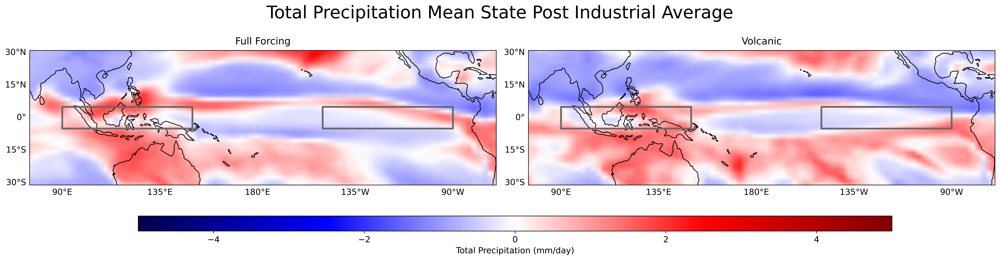

In [62]:
varplot= ' Post Industrial Average'
means = [anom_full, anom_volc]
msplot(means)

# Linear Trend Per Decade with Significance Stippling

## Define Linear Function

In [63]:
def avg(r):
    var_avg = r.mean(axis =0) 
    return(var_avg)

In [64]:
def l_trend(var,lon,lat,time,sig):
    vt =[]
    vp =[]
    nlon=len(lon)
    nlat=len(lat)
    nt=len(time)
    vart=zeros(nlat*nlon)
    varp=zeros(nlat*nlon)
    if len(var.shape)== 3:        
        var1=reshape(var,(nt,nlat*nlon)) #nlat *nlon to calculate 
        for i in range(nlat*nlon):
            v=var1[:,i]  
            vart[i], intercept, r_value, varp[i], std_err=stats.linregress(time,v) # slope, intercept, r, p, std_error
        vart=reshape(vart,(nlat,nlon))
        varp=reshape(varp,(nlat,nlon)) 
        vt.append(vart)
        vp.append(varp)
        #print(type(vp))
        slope = np.stack(vt, axis=0)#, dim='ensemble')
        #print(len(slope))
        #print(slope)
        pvalue = np.stack(vp, axis=0)#, dim='ensemble')
        #pvs= stats.combine_pvalues(pvalue[0], method='fisher', weights=None)
        ## To convert the  trend from monthly to ppm/decade, just multiply by 
        ## 12 months per year, and then multiply that by 10 years per decade
        slope_avg = (avg(slope))*12*10
        sig_pval = ma.masked_greater(pvalue, sig)
        pval_avg = avg(sig_pval)
        return (slope_avg, pval_avg)

## Calculate Linear Function

In [65]:
for ww in range(len(anom_full)):
    trend_full, pval_full = l_trend(anom_full[ww,:,:,:].values,lon,lat,year,sig=0.05)
for ww in range(len(anom_volc)):
    trend_volc pval_volc= l_trend(anom_volc[ww,:,:,:].values,lon,lat,year,sig=0.05)

In [66]:
trend_cntl, pval_cntl = l_trend(anom_cntl.values,lon,lat,i_cntlyear,sig=0.05)

ValueError: cannot reshape array of size 37584000 into shape (2400,3132)

In [68]:
trend = [trend_ghg,trend_full] #, anthro_avg]
sig_trend = [pval_ghg, pval_full] #, anthro_avgp]
lent = len(sig_trend)

## PLot Linear Function

In [69]:
df = 35 
t90=stats.t.ppf(1-0.05, df-2)
t95=stats.t.ppf(1-0.025, df-2)

In [99]:
def tplot(ep,vx):
    fig = plt.figure(figsize=(20,10))
    fig.dpi = 600
    clevs = np.arange(-1.05, 1.05, 0.05)
    dx = []
    for i in np.arange(len(ep)):
        ax = plt.subplot(1, 2, i+1, projection=ccrs.PlateCarree(central_longitude=-179.5))
        ax.set_extent([lon.min(), lon.max(), lat.min(), lat.max()], crs=ccrs.PlateCarree(central_longitude=-179.5))
        cf = ax.pcolormesh(lon, lat, ep[i], transform=ccrs.PlateCarree(),cmap='RdYlBu_r', shading='gouraud',
                           vmin = -.06, vmax =.06)
        cs = ax.contourf(lon,lat, vx[i], colors='none' ,hatches=["-\ "],extend='lower', transform=ccrs.PlateCarree())

        ax.coastlines(linewidths=1.0)
        ax.set_aspect('equal')
        ax.set_extent([75, 290, -31, 31], crs=ccrs.PlateCarree())
        fig.suptitle(variable +varplot , fontsize = 25, y= 0.7)
        ax.set_title( var_name[i] ,fontsize=14)
        #ax.text(-20,25,'Variance Explained {:.1f} %'.format(vx[i]),fontsize=9,backgroundcolor='white',horizontalalignment="right", verticalalignment ='bottom')
        ## Add in meridian and parallels
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0, color='black', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.left_labels= True
        gl.xlines = False
        gl.ylines = True
        gl.xlocator = mticker.FixedLocator([-90, -135, 180, 135, 90])
        gl.ylocator = mticker.FixedLocator([-30, -15, 0, 15, 30])
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 25, 'color': 'gray'}
        gl.xlabel_style = {'size': 12.5,'color': 'black', 'weight': 'bold'}
        gl.ylabel_style = {'size': 25, 'color': 'gray'}
        gl.ylabel_style = {'size': 12.5,'color': 'black', 'weight': 'bold'}
        ax.add_geometries([Ering], ccrs.PlateCarree(), facecolor='none', edgecolor='dimgrey', linewidth=2.5)
        ax.add_geometries([Wring], ccrs.PlateCarree(), facecolor='none', edgecolor='dimgrey', linewidth =2.5)
        gl.xlabel_style = {'size': 12}
        gl.ylabel_style = {'size': 12}
    # # add colorbar [left, bottom, width, height]
        ax2 = fig.add_axes([0.13, 0.27, 0.75, 0.03])
        cbar = fig.colorbar(cf, cax=ax2, drawedges=False, 
                        orientation='horizontal')#, extend='both')
        cbar.ax.tick_params(labelsize=12)
        cbar.set_label(plt_ylabel, fontsize=12)
        plt.subplots_adjust(hspace=-0.5, wspace=0.85)
        plt.tight_layout()
        plt.savefig(variable + "lt.jpg")

/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/2127850428.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/2127850428.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


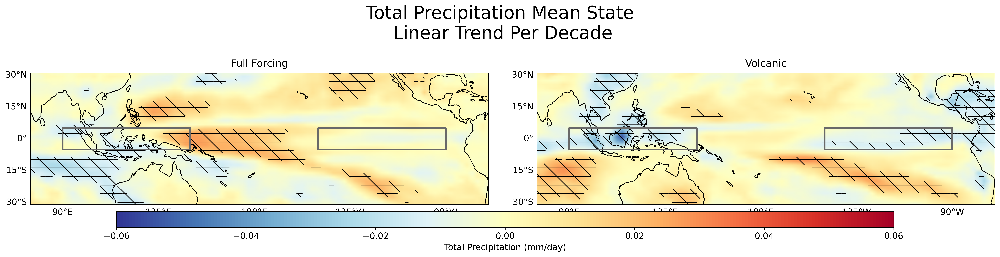

In [100]:
varplot= '\n Linear Trend Per Decade'
tplot(trend, sig_trend)

# Season Plotting

## Season Function

In [73]:
def season(m):
    dj =[]
    ma =[]
    jj =[]
    so =[]
    DA_DJF = m.sel(time=m.time.dt.season=="DJF")
    DA_MAM = m.sel(time=m.time.dt.season=="MAM")
    DA_JJA = m.sel(time=m.time.dt.season=="JJA")
    DA_SON = m.sel(time=m.time.dt.season=="SON")
    return DA_DJF, DA_MAM, DA_JJA, DA_SON

In [74]:
def year_v(yv): #redo year
    lt = len(yv[0])
    yr = np.linspace(0,lt, lt) 
    return(yr)

In [80]:
def seas_plot(ep,vx):
    fig = plt.figure(figsize=(9,10))
    fig.dpi = 600
    clevs = np.arange(-1.05, 1.05, 0.05)
    dx = []
    for i in np.arange(len(ep)):
        ax = plt.subplot(2, 2, i+1, projection=ccrs.PlateCarree(central_longitude=-179.5))
        ax.set_extent([lon.min(), lon.max(), lat.min(), lat.max()], crs=ccrs.PlateCarree(central_longitude=-179.5))
        cf = ax.pcolormesh(lon, lat, ep[i], transform=ccrs.PlateCarree(),cmap='RdYlBu_r', shading='gouraud',
                           vmin =-.1, vmax =.1)
        cs = ax.contourf(lon,lat, vx[i], colors='none' ,hatches=["-\ "],extend='lower', transform=ccrs.PlateCarree())

        ax.coastlines(linewidths=1.0)
        ax.set_aspect('equal')
        ax.set_extent([75, 290, -31, 31], crs=ccrs.PlateCarree())
        fig.suptitle(fname+variable +"\n" +varplot , fontsize = 14, y= 0.68)
        ax.set_title(var_names[i] ,fontsize=12)
        #ax.text(-20,25,'Variance Explained {:.1f} %'.format(vx[i]),fontsize=9,backgroundcolor='white',horizontalalignment="right", verticalalignment ='bottom')
        ## Add in meridian and parallels
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0, color='black', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.left_labels= True
        gl.xlines = False
        gl.ylines = True
        gl.xlocator = mticker.FixedLocator([-90, -135, 180, 135, 90])
        gl.ylocator = mticker.FixedLocator([-30, -15, 0, 15, 30])
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 25, 'color': 'gray'}
        gl.xlabel_style = {'size': 12.5,'color': 'black', 'weight': 'bold'}
        gl.ylabel_style = {'size': 25, 'color': 'gray'}
        gl.ylabel_style = {'size': 12.5,'color': 'black', 'weight': 'bold'}
        ax.add_geometries([Ering], ccrs.PlateCarree(), facecolor='none', edgecolor='dimgrey', linewidth=2.5)
        ax.add_geometries([Wring], ccrs.PlateCarree(), facecolor='none', edgecolor='dimgrey', linewidth =2.5)
        gl.xlabel_style = {'size': 10}
        gl.ylabel_style = {'size': 10}
    # # add colorbar [left, bottom, width, height]
        ax2 = fig.add_axes([0.13, 0.25, 0.75, 0.03])
        cbar = fig.colorbar(cf, cax=ax2, drawedges=False, 
                        orientation='horizontal')
        cbar.ax.tick_params(labelsize=10)
        cbar.set_label(plt_ylabel, fontsize=10)
        plt.subplots_adjust(hspace=-0.8, wspace=0.95)
        plt.tight_layout()
        plt.savefig(variable + fname+ "season.jpg")

In [81]:
#yearsea= year_v(ozasea[0])
def se(b):
    ss = season(b)
    for ww in range(len(ss[0])):
        yearsea= year_v(ss[0])
        d, dp = l_trend(ss[0][ww,:,:,:].values,lon,lat,yearsea,sig=0.05)
        m, mp = l_trend(ss[1][ww,:,:,:].values,lon,lat,yearsea,sig=0.05)
        j, jp = l_trend(ss[2][ww,:,:,:].values,lon,lat,yearsea,sig=0.05)
        s, sp = l_trend(ss[3][ww,:,:,:].values,lon,lat,yearsea,sig=0.05)
        seas = [d,m,j,s]
        seasp = [dp,mp,jp,sp]
        lent = len(seas)
    seas_plot(seas, seasp)
    return seas_plot

/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/2672131130.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/2672131130.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/2672131130.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/2672131130.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/glade/derecho/scratch/calipfleger/tmp/ipykernel_49345/2672131130.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might 

CPU times: user 30.4 s, sys: 358 ms, total: 30.8 s
Wall time: 33.3 s


<function __main__.seas_plot(ep, vx)>

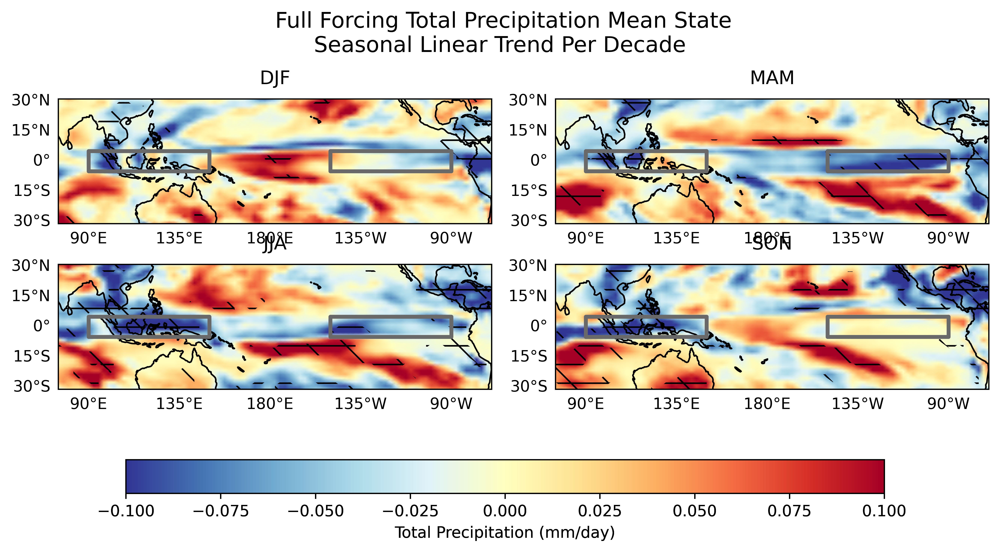

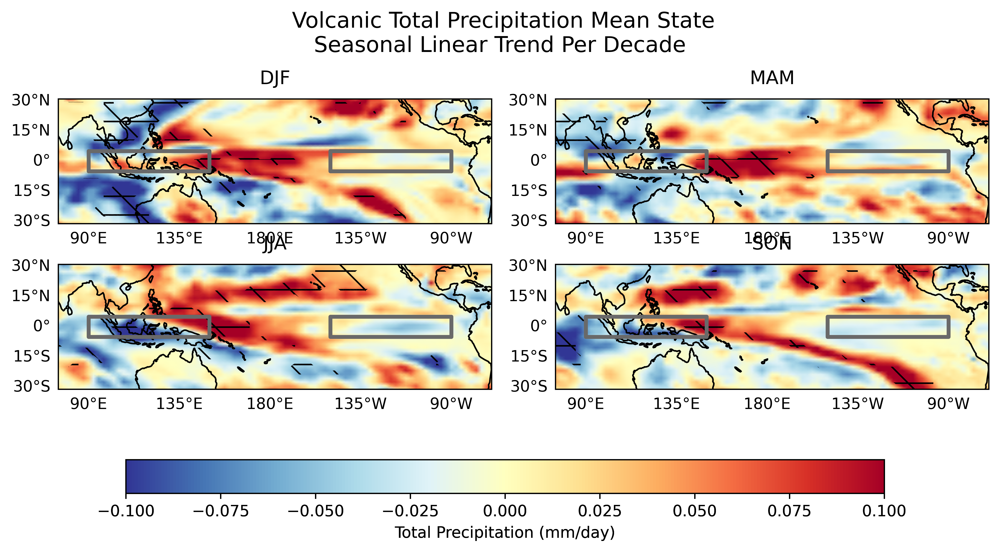

In [82]:
%%time 
varplot = 'Seasonal Linear Trend Per Decade'
fname = ' Full Forcing '
se(anom_full)
fname = ' Volcanic '
se(anom_volc)


# Function for Regional Average

In [84]:
#PWC Index 
def pwci(p):
    #p = c.groupby('time.month').mean('time')
    east=  p.sel(lat=slice(-5,5), lon=slice(180,260))  # 
    west = p.sel(lat=slice(-5,5), lon=slice(130,150))
    avg_east = east.mean(('lat', 'lon'))
    avg_west = west.mean(('lat', 'lon'))
    pwc = (avg_east - avg_west).compute()
    pwc= pwc.compute()
    return pwc, avg_east, avg_west

In [86]:
%%time
pwc, pwc_fw, pwc_fw = pwci(anom_full)
pwc_v, pwc_ve, pwc_ve  = pwci(anom_volc)
cntl, cntl_e,cntl_w = pwci(var_cntl)

CPU times: user 82.1 ms, sys: 257 µs, total: 82.4 ms
Wall time: 106 ms


# Time Series

In [95]:
t_oza = np.arange(0,1872)*dt +1850
def roll_post(r,vp):
    fig = plt.figure(figsize=(25,10))
    for i in range(len(r)):
        #ax = fig.add_subplot(6,1,i+1)
        bbres = r[1].mean(dim = 'ensemble')
        post = r[i].mean(dim = 'ensemble')
        bres = stats.linregress(t_oza,bbres)
        res = stats.linregress(t_oza,post)
        roll_avg = post.rolling(time=120, center=True).mean()
        #plt.set_title(var_name[i]) #ax
        plt.suptitle(variable +vp , fontsize = 35, y= 1)
        #plt.set_ylim([-2,.2]) #ax
        plt.ylim(-1,1)
        plt.plot(t_oza,roll_avg, label = var_namets[i], color = colors[i], linewidth=4)
        plt.plot(t_oza, (bres.intercept + bres.slope*t_oza), 'r', linewidth=3)
        plt.fill_between(t_oza, roll_avg + roll_avg.std(),
                         roll_avg - roll_avg.std(), edgecolor= colors_ribbon[i], 
                         facecolor=colors_ribbon[i], alpha=1)
        plt.ylim(-0.4,0.4)
        plt.text(2018, 0, 'slope, %0.3f' %bres.slope, fontsize = '24')
        plt.text(2018, - .1, 'pvalue, %0.3f' %bres.pvalue, fontsize = '24')
        plt.ylabel(plt_ylabel)
        plt.xlabel('Year')
        plt.rcParams['font.family']= 'sans-serif'
        plt.rcParams['font.size'] = '30'
        plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
              fancybox=True, shadow=True, ncol=4)
        #plt.tight_layout()
        plt.xlabel('Year', fontsize = '38')
        #plt.xticks(np.linspace(1850, 2005, 10))
        #plt.xticks(ticks=True, labels=None,  minor=True)
        plt.savefig(variable + "ts10.jpg")

In [97]:
pwc_in= [pwc,pwc_v]

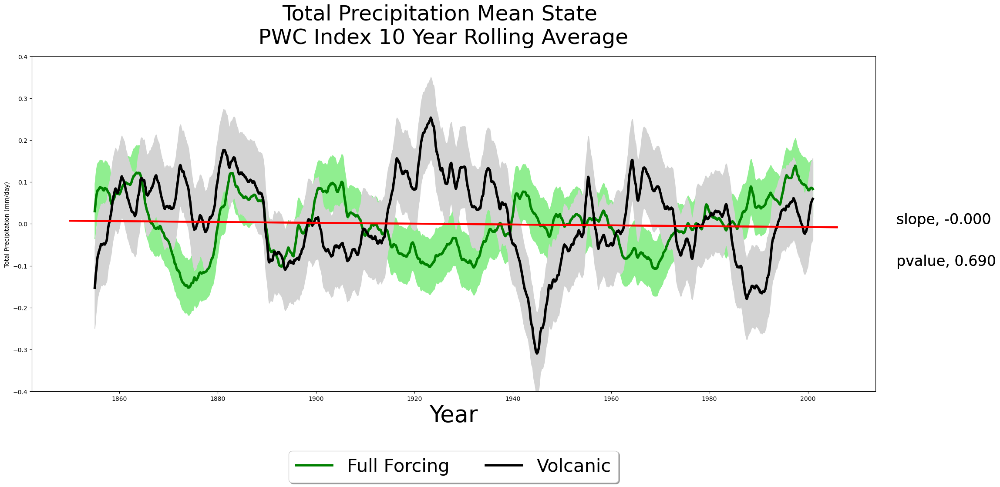

In [98]:
#for i in range(len(pwc_in)):
vp =  '\n PWC Index 10 Year Rolling Average'
roll_post(pwc_in, vp)